In [2]:
import torch
from PIL import Image
import wandb
import torchmetrics
from torchvision.models import alexnet, inception_v3
import json
import os
from os.path import join as opj
from torchvision.transforms import *
import numpy as np
from scipy import signal
import tqdm
from torchsummary import summary
from torchvision.models.feature_extraction import get_graph_node_names
from torchvision.models.feature_extraction import create_feature_extractor
import clip
from torchmetrics.image.fid import FrechetInceptionDistance
import pandas as pd
import matplotlib.pyplot as plt
import pickle

In [3]:
target_run="eager-river-4" 

api=wandb.Api()
project=api.project("BrainDecodingNSD_MNI")

entity, project = "matteoferrante", "BrainDecodingNSD_MNI"  # set to your entity and project
runs = api.runs(entity + "/" + project)

In [4]:
def get_data(method,fraction,version):
    active_run=None
    for run in api.runs(project):
        if run.name==target_run:
            print(f"found {target_run}")
            active_run=target_run

            for artifact in run.logged_artifacts():
                artifact_path = artifact.download()

                if f"table_{method}_{fraction}:{version}" in artifact_path:
                    decoded_artifact=artifact_path
                    f=open(f"{artifact_path}/table_{method}_{fraction}.table.json")
                    meta = json.load(f)
                    data=meta["data"]
                    shown=[]
                    subj01=[]
                    subj02=[]
                    subj05=[]
                    subj07=[]
                    for i in range(len(data)):
                        shown.append(data[i][0]["path"])
                        subj01.append(data[i][1]["path"])
                        subj02.append(data[i][2]["path"])
                        subj05.append(data[i][3]["path"])
                        subj07.append(data[i][4]["path"])

                        # gen=[]
                        # for j in range(1,len(data[i])):
                        #     gen.append(data[i][j]["path"])
                        # generated.append(gen)
                    print(artifact_path)
                    break
            
    return shown,subj01,subj02,subj05,subj07,decoded_artifact
            
            
        

In [39]:
method="ridge"
fraction=50
version="v0"

shown,subj01,subj02,subj05,subj07,decoded_artifact=get_data(method,fraction,version)

shown_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in shown[:30]]
subj01_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj01[:30]]
subj02_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj02[:30]]
subj05_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj05[:30]]
subj07_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj07[:30]]


found eager-river-4


wandb:   21 of 21 files downloaded.  
wandb:   21 of 21 files downloaded.  
wandb:   41 of 41 files downloaded.  
wandb: Downloading large artifact run-59s9cbrb-table_ridge_100:v1, 1669.57MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:0.9
wandb: Downloading large artifact run-59s9cbrb-table_ridge_50:v0, 1657.90MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:0.9


./artifacts/run-59s9cbrb-table_ridge_50:v0


In [19]:


def plot_images(image_list, stimuli, column_titles, offset=0, num_rows=5):
    # num_rows = len(image_list[0])
    num_cols = len(image_list) + 1  # Increase number of columns for the stimulus column
    
    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(4*num_cols, 4*num_rows))

    # Plot the stimuli in the first column
    for i in range(num_rows):
        axes[i, 0].imshow(stimuli[i+offset])
        axes[0, 0].set_title("stimulus")
        axes[i, 0].axis('off')

    # Plot the remaining images
    for i in range(num_rows):
        for j in range(1, num_cols):
            axes[i, j].imshow(image_list[j-1][i+offset])
            axes[0, j].set_title(column_titles[j-1])
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()
    return fig

# Assuming image_list contains the list of PIL Images


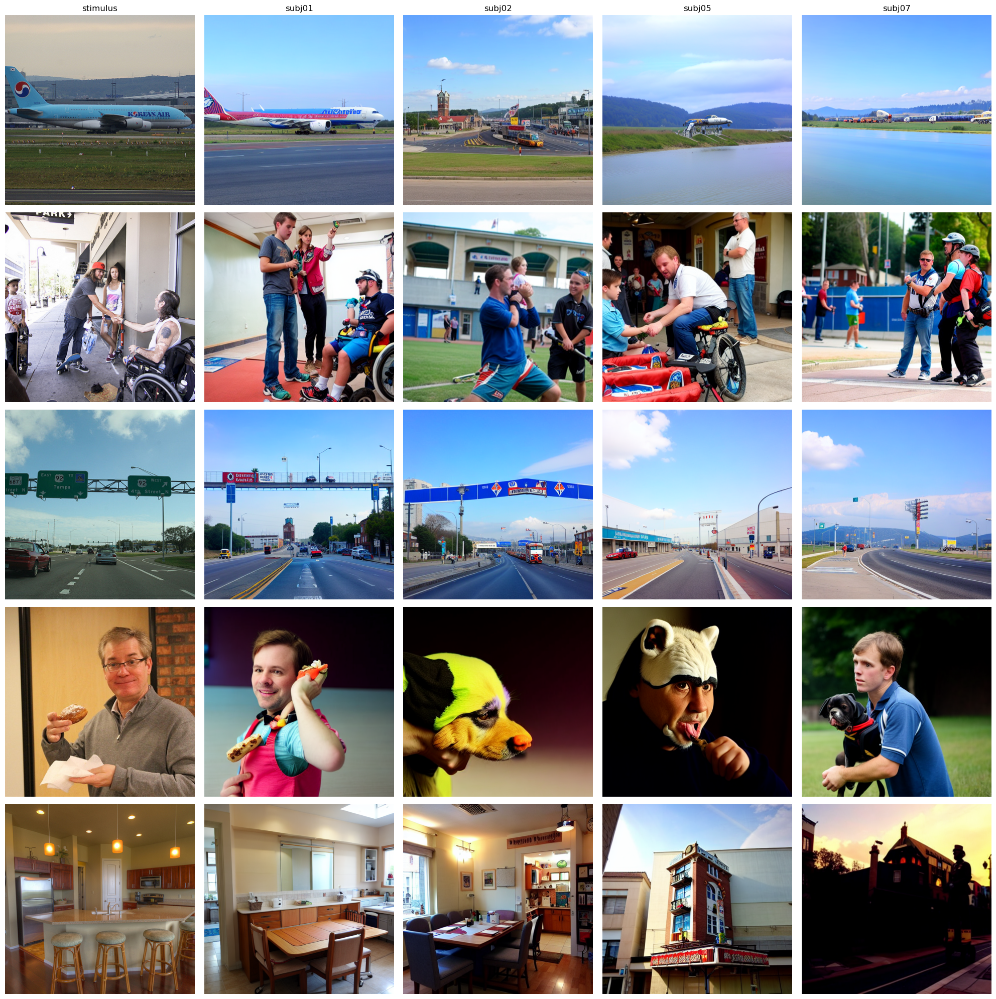

In [47]:

# Assuming column_titles contains the corresponding titles for each image
column_titles = ["subj01", "subj02", "subj05", "subj07"]
offset=0
fig=plot_images([subj01_imgs,subj02_imgs,subj05_imgs,subj07_imgs],shown_imgs,column_titles=column_titles,offset=offset)

fig.savefig(f"figures/subj01_{method}_{fraction}_idx_{offset}.png")

## Compare across fractions

In [49]:
method="ridge"

shown_frac=[]
subj01_frac=[]
subj02_frac=[]
subj05_frac=[]
subj07_frac=[]
for fraction in [10,25,50,100]:
    
    if fraction==100:
        version="v1"
    else:
        version="v0"
    shown,subj01,subj02,subj05,subj07,decoded_artifact=get_data(method,fraction,version)

    shown_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in shown[:30]]
    subj01_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj01[:30]]
    subj02_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj02[:30]]
    subj05_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj05[:30]]
    subj07_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj07[:30]]
    
    subj01_frac.append(subj01_imgs)
    subj02_frac.append(subj02_imgs)
    subj05_frac.append(subj05_imgs)
    subj07_frac.append(subj07_imgs)
    
    

found eager-river-4


wandb:   21 of 21 files downloaded.  
wandb:   21 of 21 files downloaded.  
wandb:   41 of 41 files downloaded.  
wandb: Downloading large artifact run-59s9cbrb-table_ridge_100:v1, 1669.57MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.0
wandb: Downloading large artifact run-59s9cbrb-table_ridge_50:v0, 1657.90MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.1
wandb: Downloading large artifact run-59s9cbrb-table_ridge_25:v0, 1649.79MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:0.9
wandb: Downloading large artifact run-59s9cbrb-table_ridge_10:v0, 1653.21MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:0.9


./artifacts/run-59s9cbrb-table_ridge_10:v0
found eager-river-4


wandb:   21 of 21 files downloaded.  
wandb:   21 of 21 files downloaded.  
wandb:   41 of 41 files downloaded.  
wandb: Downloading large artifact run-59s9cbrb-table_ridge_100:v1, 1669.57MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.0
wandb: Downloading large artifact run-59s9cbrb-table_ridge_50:v0, 1657.90MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.0
wandb: Downloading large artifact run-59s9cbrb-table_ridge_25:v0, 1649.79MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.0


./artifacts/run-59s9cbrb-table_ridge_25:v0
found eager-river-4


wandb:   21 of 21 files downloaded.  
wandb:   21 of 21 files downloaded.  
wandb:   41 of 41 files downloaded.  
wandb: Downloading large artifact run-59s9cbrb-table_ridge_100:v1, 1669.57MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.0
wandb: Downloading large artifact run-59s9cbrb-table_ridge_50:v0, 1657.90MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.0


./artifacts/run-59s9cbrb-table_ridge_50:v0
found eager-river-4


wandb:   21 of 21 files downloaded.  
wandb:   21 of 21 files downloaded.  
wandb:   41 of 41 files downloaded.  
wandb: Downloading large artifact run-59s9cbrb-table_ridge_100:v1, 1669.57MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.0


./artifacts/run-59s9cbrb-table_ridge_100:v1


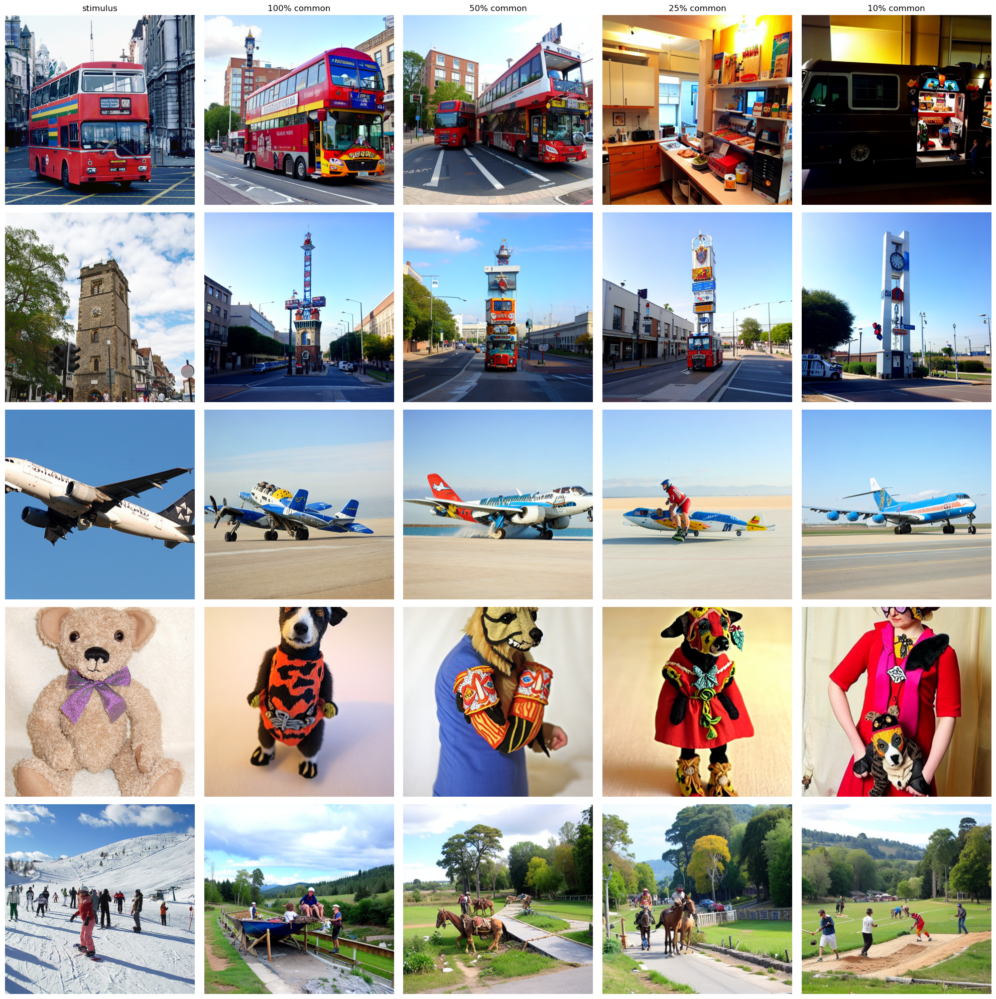

In [59]:
column_titles = ["10% common", "25% common", "50% common", "100% common"]
offset=25
fig=plot_images(subj02_frac[::-1],shown_imgs,column_titles=column_titles[::-1],offset=offset)

fig.savefig(f"figures/subj01_RIDGE_COMPARISON_subj02_{offset}.png")

### Comparison Across modalities

In [61]:

shown_mod=[]
subj01_mod=[]
subj02_mod=[]
subj05_mod=[]
subj07_mod=[]
for method in ["ridge","hyper","anat"]:
    fraction=100

    if method=="ridge":
        version="v1"
    else:
        version="v0"
        
    if method=="anat":
        fraction=10
    shown,subj01,subj02,subj05,subj07,decoded_artifact=get_data(method,fraction,version)

    shown_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in shown[:30]]
    subj01_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj01[:30]]
    subj02_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj02[:30]]
    subj05_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj05[:30]]
    subj07_imgs=[Image.open(opj(decoded_artifact,i)).convert("RGB") for i in subj07[:30]]
    
    subj01_mod.append(subj01_imgs)
    subj02_mod.append(subj02_imgs)
    subj05_mod.append(subj05_imgs)
    subj07_mod.append(subj07_imgs)
    
    

found eager-river-4


wandb:   21 of 21 files downloaded.  
wandb:   21 of 21 files downloaded.  
wandb:   41 of 41 files downloaded.  
wandb: Downloading large artifact run-59s9cbrb-table_ridge_100:v1, 1669.57MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:0.9


./artifacts/run-59s9cbrb-table_ridge_100:v1
found eager-river-4


wandb:   21 of 21 files downloaded.  
wandb:   21 of 21 files downloaded.  
wandb:   41 of 41 files downloaded.  
wandb: Downloading large artifact run-59s9cbrb-table_ridge_100:v1, 1669.57MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.0
wandb: Downloading large artifact run-59s9cbrb-table_ridge_50:v0, 1657.90MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.0
wandb: Downloading large artifact run-59s9cbrb-table_ridge_25:v0, 1649.79MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.0
wandb: Downloading large artifact run-59s9cbrb-table_ridge_10:v0, 1653.21MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.1
wandb: Downloading large artifact run-59s9cbrb-table_anat_10:v0, 1040.74MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:0.8
wandb: Downloading large artifact run-59s9cbrb-table_hyper_100:v0, 1662.80MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:0

./artifacts/run-59s9cbrb-table_hyper_100:v0
found eager-river-4


wandb:   21 of 21 files downloaded.  
wandb:   21 of 21 files downloaded.  
wandb:   41 of 41 files downloaded.  
wandb: Downloading large artifact run-59s9cbrb-table_ridge_100:v1, 1669.57MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:1.0
wandb: Downloading large artifact run-59s9cbrb-table_ridge_50:v0, 1657.90MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:0.9
wandb: Downloading large artifact run-59s9cbrb-table_ridge_25:v0, 1649.79MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:0.8
wandb: Downloading large artifact run-59s9cbrb-table_ridge_10:v0, 1653.21MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:0.9
wandb: Downloading large artifact run-59s9cbrb-table_anat_10:v0, 1040.74MB. 4911 files... 
wandb:   4911 of 4911 files downloaded.  
Done. 0:0:0.8


./artifacts/run-59s9cbrb-table_anat_10:v0


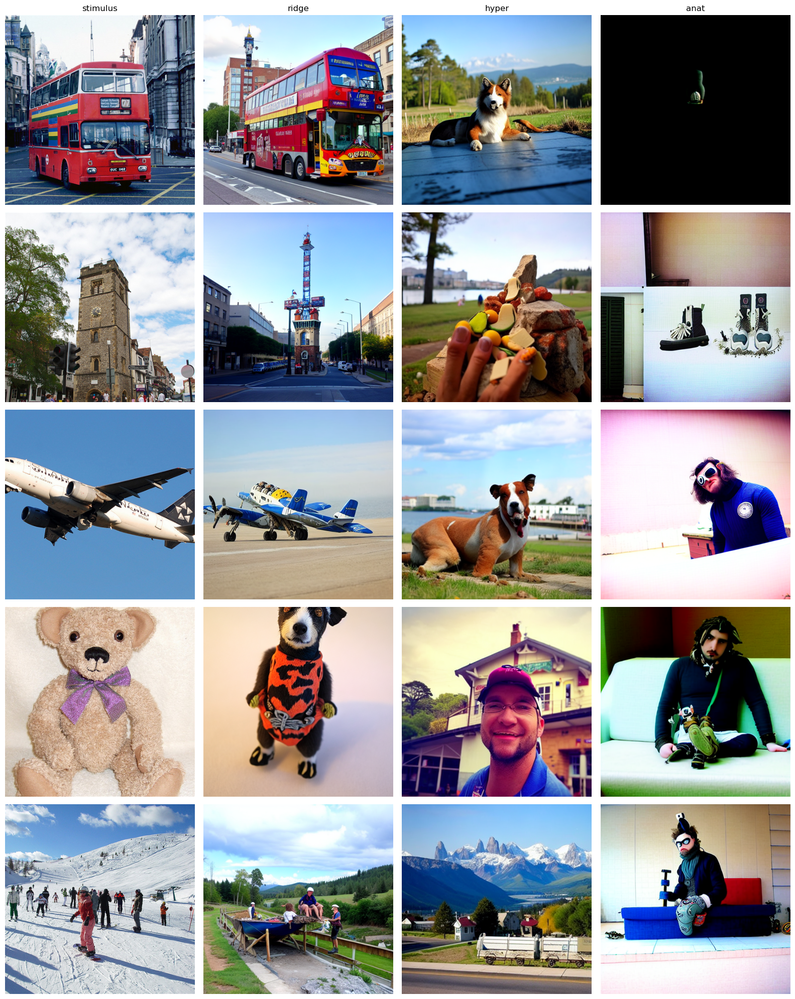

In [67]:
column_titles = ["ridge", "hyper", "anat"]
offset=25
fig=plot_images(subj02_mod,shown_imgs,column_titles=column_titles,offset=offset)

fig.savefig(f"figures/subj01_MODE_COMPARISON_subj02_{offset}.png")